Define headers

In [2]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
# from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog

Define Dataset

In [3]:
import os
import numpy as np
import json
from detectron2.structures import BoxMode
import cv2
from PIL import Image

def get_ball_dicts():
    txt_file = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "open_images.txt")
    f = open(txt_file, "r")
    c=0
    dataset_dicts = []
    
    for line in f:
        record = {}
        objs = []
        c+=1

        filename=line[49+4:69+4]
        width, height = Image.open(os.path.join("/home/danielarato/ball_detection/Datasets/train/Ball/", filename)).size

        record["file_name"] = os.path.join("/home/danielarato/ball_detection/Datasets/train/Ball/", filename)
        record["image_id"] = c
        record["height"] = height
        record["width"] = width

        label_txt="/home/danielarato/ball_detection/Datasets/train/Label/"+filename[:16]+".txt"
        f_label = open(label_txt, "r")

        for line_label in f_label:
            px=[]
            py=[]
#             print(line_label)
            x = line_label.split()
#             print(x)
            px.append(float(x[1]))
            px.append(float(x[3]))
            py.append(float(x[2]))
            py.append(float(x[4]))
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
                "iscrowd": 0
            }
            objs.append(obj)    
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

def get_ball_dicts_grayscale():
    txt_file = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "open_images_grayscale.txt")
    f = open(txt_file, "r")
    c=0
    dataset_dicts = []
    
    for line in f:
        record = {}
        objs = []
        c+=1

        filename=line[49+4+1:69+4+1]
#         print(filename)
        width, height = Image.open(os.path.join("/home/danielarato/ball_detection/Datasets/train/Grayscale/", filename)).size

        record["file_name"] = os.path.join("/home/danielarato/ball_detection/Datasets/train/Grayscale/", filename)
        record["image_id"] = c
        record["height"] = height
        record["width"] = width

        label_txt="/home/danielarato/ball_detection/Datasets/train/Label/"+filename[:16]+".txt"
        f_label = open(label_txt, "r")

        for line_label in f_label:
            px=[]
            py=[]
#             print(line_label)
            x = line_label.split()
#             print(x)
            px.append(float(x[1]))
            px.append(float(x[3]))
            py.append(float(x[2]))
            py.append(float(x[4]))
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = [p for x in poly for p in x]

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                "category_id": 0,
                "iscrowd": 0
            }
            objs.append(obj)    
        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts


from detectron2.data import DatasetCatalog, MetadataCatalog
DatasetCatalog.register("Ball_train", lambda:get_ball_dicts())
MetadataCatalog.get("Ball_train").set(thing_classes=["Ball"])
ball_metadata = MetadataCatalog.get("Ball_train")


DatasetCatalog.register("Ball_train_bw", lambda:get_ball_dicts_grayscale())
MetadataCatalog.get("Ball_train_bw").set(thing_classes=["Ball"])
ball_metadata = MetadataCatalog.get("Ball_train_bw")

Confirm if datasets works

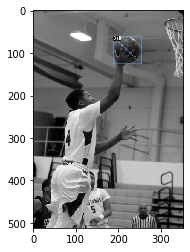

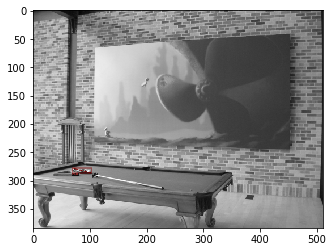

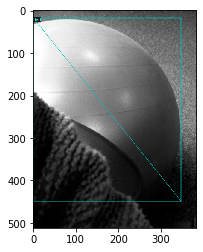

In [4]:
import random 
import matplotlib.pyplot as plt
dataset_dicts = get_ball_dicts_grayscale()
ball_metadata = MetadataCatalog.get("Ball_train_bw")
# print (dataset_dicts)
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=ball_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure()
    plt.imshow(vis.get_image()[:, :, ::-1])
    


In [5]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import torch
torch.cuda.set_device(2)
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml"))
cfg.DATASETS.TRAIN = ("Ball_train_bw",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_C4_1x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 7000    # 300 iterations seems good enough for this toy dataset; you may need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1  # only has one class (ballon)

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=True)
trainer.train()

[02/05 06:10:54 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

[02/05 06:10:54 d2.data.build]: Removed 0 images with no usable annotations. 3480 images left.
[02/05 06:10:54 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    Ball    | 6845         |
|            |              |
[02/05 06:10:54 d2.data.detection_utils]: TransformGens used in training: [ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style='choice'), RandomFlip()]
[02/05 06:10:54 d2.data.build]: Using training sampler TrainingSampler
[02/05 06:10:54 d2.engine.train_loop]: Starting training from iteration 7000
[02/05 06:10:54 d2.engine.hooks]: Total training time: 0:00:00 (0:00:00 on hooks)


OrderedDict()

In [6]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold for this model
cfg.DATASETS.TEST = ("ball_train", )
predictor = DefaultPredictor(cfg)

In [7]:
# cameraMatrix=[[708.30536, 0, 170.51079],
#  [0, 714.59424, 130.0705],
#  [0, 0, 1]]
from detectron2.utils.visualizer import ColorMode
import numpy as np
import time

d_real=0.63 *1000#mm

cameraMatrix_IR=np.array([[725.790155, 0, 191.397201],
[0, 733.580771, 149.464123],
[0, 0, 1]])

# 708.305362, 0.000000, 170.510788, 0.000000, 714.594222, 130.070494, 0.000000, 0.000000, 1.000000


print(cameraMatrix_IR)

fx=cameraMatrix_IR[0][0]
fy=cameraMatrix_IR[1][1]
cx=cameraMatrix_IR[0][2]
cy=cameraMatrix_IR[1][2]
print(fx,fy,cx,cy)

[[725.790155   0.       191.397201]
 [  0.       733.580771 149.464123]
 [  0.         0.         1.      ]]
725.790155 733.580771 191.397201 149.464123


In [8]:
cameraMatrix_RGB=np.array([[2168.684845,0,965.374725],
[0,2180.313918,699.133011],
[0,0,1]])


cameraMatrix_mono=np.array([[2363.738690444174,0,1072.79004424623],
[0,2370.592662770868, 788.4498446284557],
[0,0,1]])

cameraMatrix_RGB=cameraMatrix_mono

fx_rgb=cameraMatrix_RGB[0][0]
fy_rgb=cameraMatrix_RGB[1][1]
cx_rgb=cameraMatrix_RGB[0][2]
cy_rgb=cameraMatrix_RGB[1][2]
print(fx_rgb,fy_rgb,cx_rgb,cy_rgb)

2363.738690444174 2370.592662770868 1072.79004424623 788.4498446284557


<h1> Plot 3D real points </h1>

183


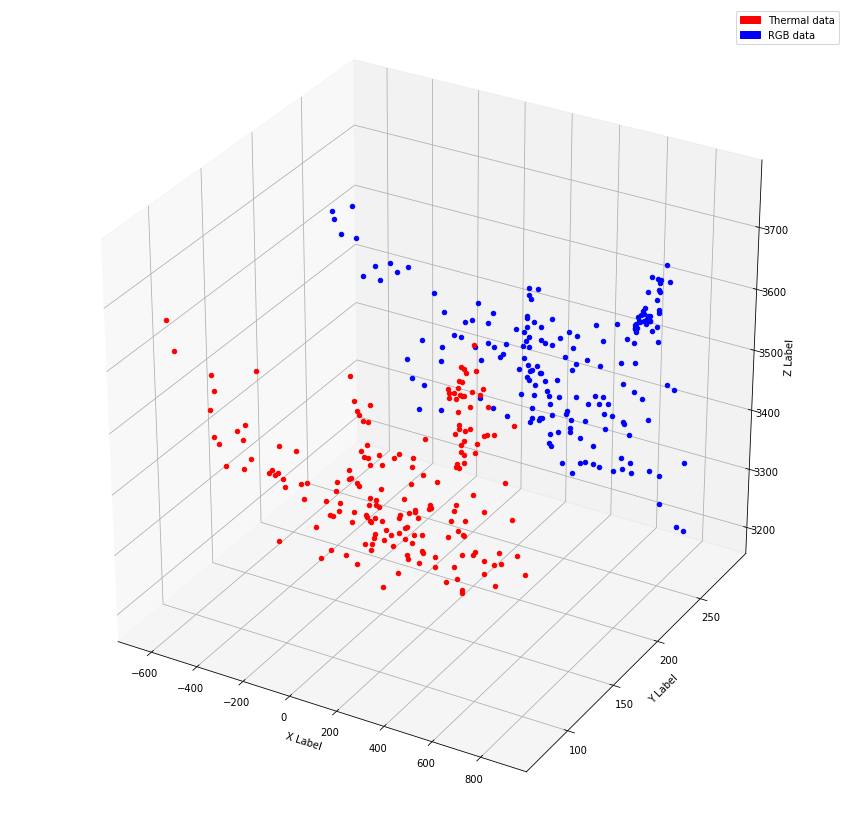

In [9]:
import matplotlib.patches as mpatches
from mpl_toolkits.mplot3d import Axes3D
#read txt files with image path
txt_file_rgb =os.path.join("/home/danielarato/ball_detection/Datasets/train/compilation/", "compilation_RGB.txt")
# txt_file_rgb = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "RGB_camera.txt")

f_rgb = open(txt_file_rgb, "r")

# txt_file_ir = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "IR_camera.txt")
txt_file_ir = os.path.join("/home/danielarato/ball_detection/Datasets/train/compilation/", "compilation_IR.txt")

f_ir = open(txt_file_ir, "r")

#iniciate 3d plot
fig = plt.figure(figsize=(15,15))
ax = fig.add_subplot(111, projection='3d' )
blue_patch = mpatches.Patch(color='blue', label='RGB data')
red_patch = mpatches.Patch(color='red', label='Thermal data')
plt.legend(handles=[red_patch,blue_patch])

ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')


#initiate vectors
Xt=[]
Yt=[]
Zt=[]
Xr=[]
Yr=[]
Zr=[]
xpi=[]
ypi=[]
xpr=[]
ypr=[]
c=0

#for each figure in the path
for line_rgb in f_rgb: 
# read images and calculate detected bounding box for each camera
    im_rgb = cv2.imread(line_rgb[:len(line_rgb)-1])
    outputs_rgb = predictor(im_rgb)
    results_rgb=outputs_rgb["instances"].to("cpu")
    
    line_ir=f_ir.readline()
    if(line_ir==""):
        break
    im_ir = cv2.imread(line_ir[:len(line_ir)-1])
    outputs_ir = predictor(im_ir)
    results_ir=outputs_ir["instances"].to("cpu")

# CALCULATE CENTERS - remove images without detection in both timestamp
    if(len(results_rgb)!=0 and len(results_ir)!=0 ):
        coordinates_ir=results_ir.pred_boxes.tensor[0].numpy()
        coordinates_rgb=results_rgb.pred_boxes.tensor[0].numpy()
        
        cond1=(abs((coordinates_rgb[2]-coordinates_rgb[0])-(coordinates_rgb[3]-coordinates_rgb[1]))>=0.05*max((coordinates_rgb[2]-coordinates_rgb[0]),(coordinates_rgb[3]-coordinates_rgb[1])))
        cond2=(abs((coordinates_ir[2]-coordinates_ir[0])-(coordinates_ir[3]-coordinates_ir[1]))>=0.05*max((coordinates_ir[2]-coordinates_ir[0]),(coordinates_ir[3]-coordinates_ir[1])))

        if(cond1==False and cond2==False):
            #VISUAL
            xc_rgb=(coordinates_rgb[2]-coordinates_rgb[0])/2+coordinates_rgb[0]
            yc_rgb=(coordinates_rgb[3]-coordinates_rgb[1])/2+coordinates_rgb[1]
            xc_rgb=float("%0.2f"%xc_rgb)
            yc_rgb=float("%0.2f"%yc_rgb)

            dx_rgb=float("%0.2f"%(float("%0.2f"%coordinates_rgb[2])-float("%0.2f"%coordinates_rgb[0])))
            dy_rgb=float("%0.2f"%(float("%0.2f"%coordinates_rgb[3])-float("%0.2f"%coordinates_rgb[1])))
            d_pix_rgb=(dx_rgb+dy_rgb)/2

            Z_rgb=((fx_rgb+fy_rgb)/2)*(d_real/d_pix_rgb)
            X_rgb=(Z_rgb*(xc_rgb-cx_rgb))/fx_rgb
            Y_rgb=(Z_rgb*(yc_rgb-cy_rgb))/fy_rgb

            ax.scatter(X_rgb, Y_rgb, Z_rgb, c='b') #draw in plot
            #IR
            xc=(coordinates_ir[2]-coordinates_ir[0])/2+coordinates_ir[0]
            yc=(coordinates_ir[3]-coordinates_ir[1])/2+coordinates_ir[1]
            xc=float("%0.2f"%xc)
            yc=float("%0.2f"%yc)

            dx=float("%0.2f"%(float("%0.2f"%coordinates_ir[2])-float("%0.2f"%coordinates_ir[0])))
            dy=float("%0.2f"%(float("%0.2f"%coordinates_ir[3])-float("%0.2f"%coordinates_ir[1])))
            d_pix=(dx+dy)/2

            Z_ir=((fx+fy)/2)*(d_real/d_pix)
            X_ir=(Z_ir*(xc-cx))/fx
            Y_ir=(Z_ir*(yc-cy))/fy
            pix_ir=np.array([xc,yc,1])

            #append points
            Xr.append(X_rgb)
            Yr.append(Y_rgb)
            Zr.append(Z_rgb)
            Xt.append(X_ir)
            Yt.append(Y_ir)
            Zt.append(Z_ir) 
            xpr.append(xc_rgb)
            ypr.append(yc_rgb)
            xpi.append(xc)
            ypi.append(yc)

            ax.scatter(X_ir, Y_ir, Z_ir, c='r') #draw in plot
            
            c+=1
f_ir.close()        
f_rgb.close()
print(c)

In [10]:
cameraPoints_IR= cameraMatrix_IR.T @ (Z_ir*pix_ir)

print(cameraMatrix_IR.T)
print(cameraPoints_IR)
print(X_ir, Y_ir, Z_ir)
print(pix_ir)

[[725.790155   0.         0.      ]
 [  0.       733.580771   0.      ]
 [191.397201 149.464123   1.      ]]
[8.20000002e+08 4.62956711e+08 3.10570280e+08]
618.4690573820506 135.43228119820924 3557.650750222497
[317.57 177.39   1.  ]


<h1>Plot pixel points vs real distance to ball</h1>

[315.7, 284.18, 280.01, 277.0, 247.41, 243.66, 242.3, 240.1, 211.94, 208.52, 205.71, 179.26, 177.29, 174.84, 153.59, 151.25, 146.72, 122.24, 106.24, 101.53, 98.77, 98.74, 85.45, 82.14, 81.68, 67.52, 66.19, 64.89, 82.4, 90.19, 92.94, 126.61, 129.22, 133.77, 166.52, 208.2, 211.19, 214.88, 233.22, 235.71, 240.6, 257.14, 258.52, 259.61, 261.01, 279.9, 280.7, 282.14, 296.37, 296.37, 310.37, 312.93, 312.95, 307.69, 304.53, 298.04, 267.98, 264.27, 261.2, 231.46, 226.78, 223.28, 201.53, 198.9, 196.53, 165.05, 162.62, 129.21, 99.3, 94.94, 294.13, 292.62, 290.14, 271.93, 270.53, 268.17, 255.01, 251.04, 250.13, 236.05, 237.25, 235.03, 223.06, 222.97, 215.4, 214.41, 213.93, 208.47, 207.26, 207.64, 204.42, 201.04, 201.73, 200.84, 200.12, 200.47, 200.8, 199.49, 200.54, 202.53, 203.63, 207.16, 207.48, 207.81, 212.54, 215.07, 215.54, 219.11, 218.97, 219.08, 222.37, 224.95, 226.43, 233.66, 233.71, 234.8, 244.03, 245.52, 244.89, 254.77, 256.04, 257.6, 269.07, 271.3, 271.76, 284.44, 286.83, 287.06, 300.2

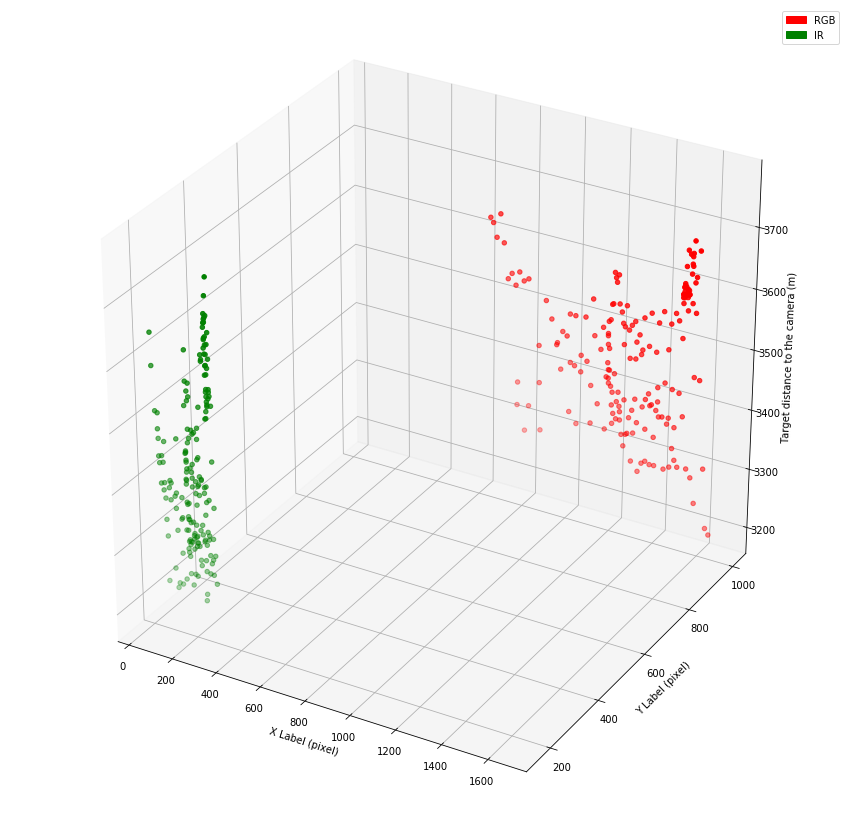

In [11]:
fig3 = plt.figure(figsize=(15,15))
ax3 = fig3.add_subplot(111, projection='3d' )
blue_patch = mpatches.Patch(color='green', label='IR')
red_patch = mpatches.Patch(color='red', label='RGB')
plt.legend(handles=[red_patch,blue_patch])
ax3.set_xlabel('X Label (pixel)')
ax3.set_ylabel('Y Label (pixel)')
ax3.set_zlabel('Target distance to the camera (m)')


ax3.scatter(xpr,ypr,Zr, c='r')
ax3.scatter(xpi,ypi,Zt, c='g')
print(xpi)
print(xpr)

<h1>Plot Ball Center in Pixels</h1>

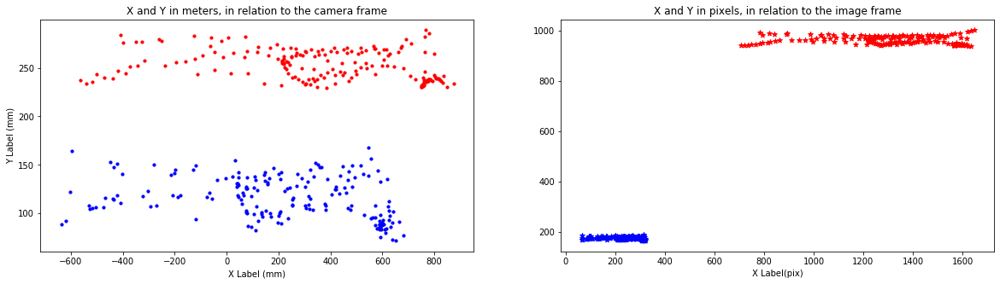

In [12]:
import matplotlib.pyplot as plt

fig0, axs_0 = plt.subplots(1,2,figsize=(20,5))

axs_0[0].scatter(Xr,Yr,c='r',s=10)
axs_0[0].scatter(Xt,Yt,c='b',s=10)
axs_0[0].set_xlabel('X Label (mm)')
axs_0[0].set_ylabel('Y Label (mm)')
axs_0[0].set_title('X and Y in meters, in relation to the camera frame')

axs_0[1].scatter(xpr,ypr,c='r',marker="*")
axs_0[1].scatter(xpi,ypi,c='b',marker="*")
axs_0[1].set_xlabel('X Label(pix)')
axs_0[1].set_title('X and Y in pixels, in relation to the image frame')

plt.show()

<h1>Draw images with bounding boxes and legend with coordinates in meters and pixels</h1>

/home/danielarato/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


AttributeError: 'NoneType' object has no attribute 'shape'

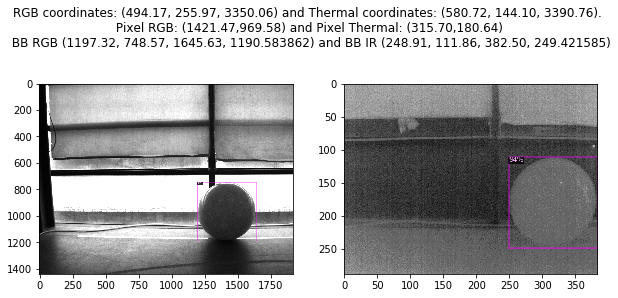

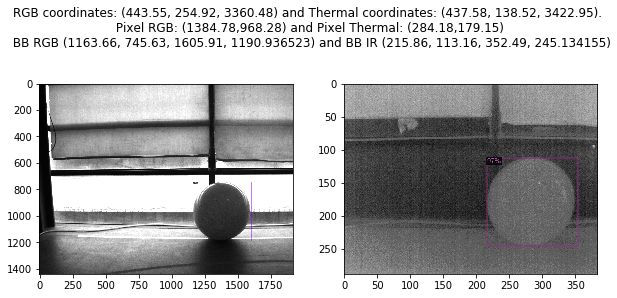

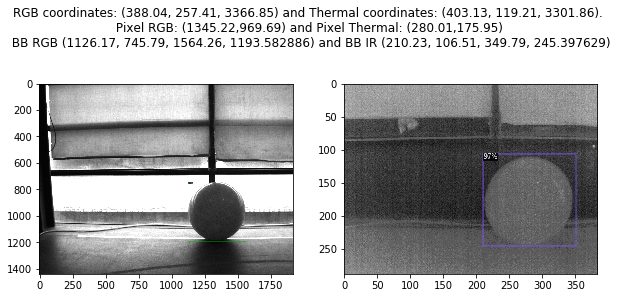

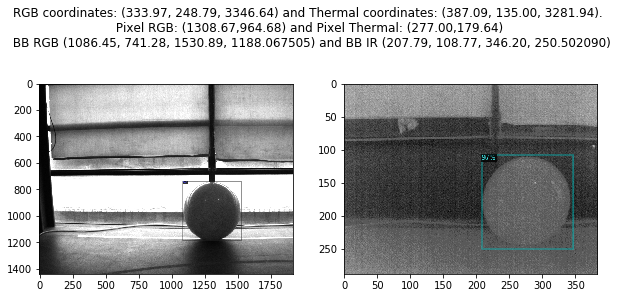

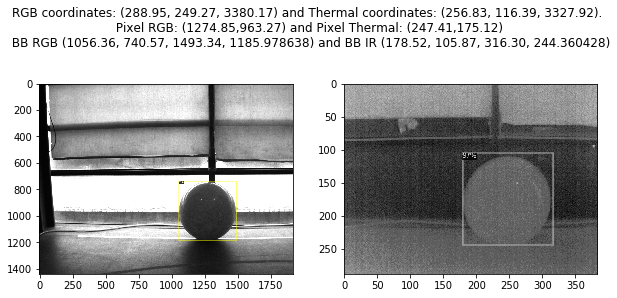

...

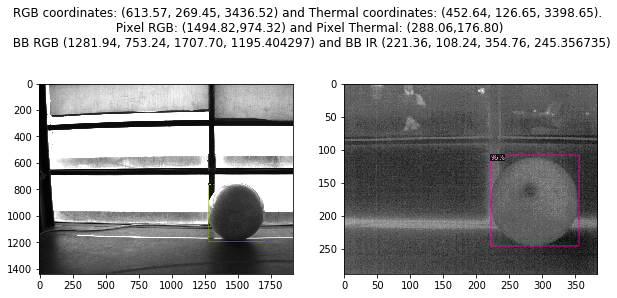

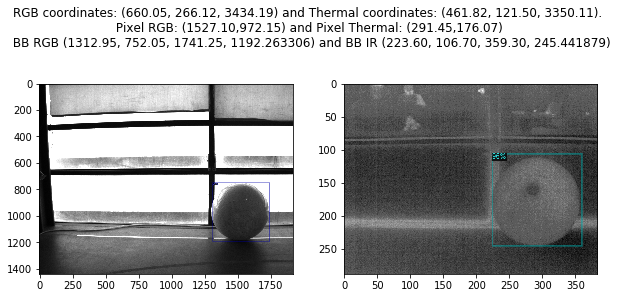

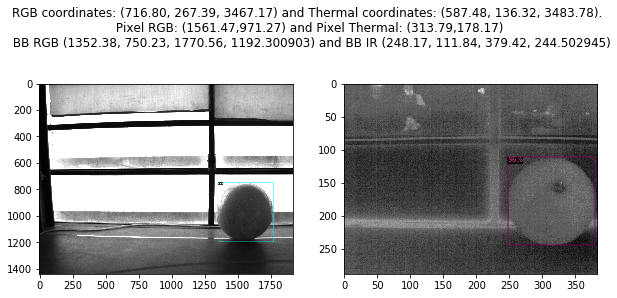

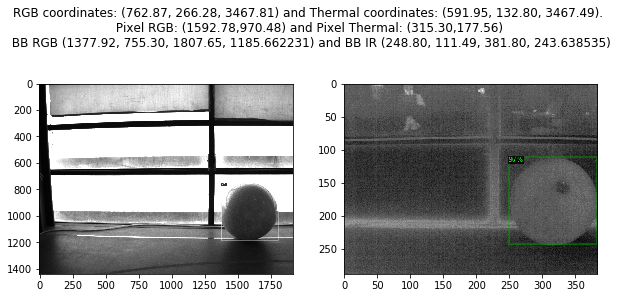

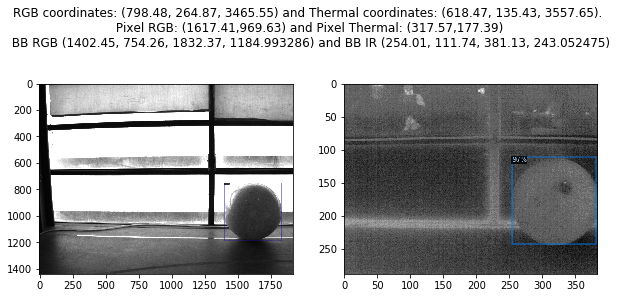

In [13]:
import matplotlib.patches as mpatches
from mpl_toolkits.mplot3d import Axes3D
#read txt files with image path
txt_file_rgb = os.path.join("/home/danielarato/ball_detection/Datasets/train/compilation/", "compilation_RGB.txt")
# txt_file_rgb = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "RGB_camera.txt")
f_rgb = open(txt_file_rgb, "r")

# txt_file_ir = os.path.join("/home/danielarato/ball_detection/Datasets/train/", "IR_camera.txt")
txt_file_ir = os.path.join("/home/danielarato/ball_detection/Datasets/train/compilation/", "compilation_IR.txt")
f_ir = open(txt_file_ir, "r")

#initiate vectors
Xt=[]
Yt=[]
Zt=[]
Xr=[]
Yr=[]
Zr=[]
xpi=[]
ypi=[]
xpr=[]
ypr=[]
c=0

#for each figure in the path
for line_rgb in f_rgb: 
# read images and calculate detected bounding box for each camera

    im_rgb = cv2.imread(line_rgb[:len(line_rgb)-1])
    outputs_rgb = predictor(im_rgb)
    results_rgb=outputs_rgb["instances"].to("cpu")
    
    line_ir=f_ir.readline()
    im_ir = cv2.imread(line_ir[:len(line_ir)-1])
    outputs_ir = predictor(im_ir)
    results_ir=outputs_ir["instances"].to("cpu")


# CALCULATE CENTERS - remove images without detection in both timestamp
    if(len(results_rgb)!=0 and len(results_ir)!=0 ):
        coordinates_ir=results_ir.pred_boxes.tensor[0].numpy()
        coordinates_rgb=results_rgb.pred_boxes.tensor[0].numpy()
        
        cond1=(abs((coordinates_rgb[2]-coordinates_rgb[0])-(coordinates_rgb[3]-coordinates_rgb[1]))>=0.07*max((coordinates_rgb[2]-coordinates_rgb[0]),(coordinates_rgb[3]-coordinates_rgb[1])))
        cond2=(abs((coordinates_ir[2]-coordinates_ir[0])-(coordinates_ir[3]-coordinates_ir[1]))>=0.07*max((coordinates_ir[2]-coordinates_ir[0]),(coordinates_ir[3]-coordinates_ir[1])))

        if(cond1==False and cond2==False):
            fig, axs = plt.subplots(1,2,figsize=(10,5))

            #VISUAL
            xc_rgb=(coordinates_rgb[2]-coordinates_rgb[0])/2+coordinates_rgb[0]
            yc_rgb=(coordinates_rgb[3]-coordinates_rgb[1])/2+coordinates_rgb[1]
            xc_rgb=float("%0.2f"%xc_rgb)
            yc_rgb=float("%0.2f"%yc_rgb)

            dx_rgb=float("%0.2f"%(float("%0.2f"%coordinates_rgb[2])-float("%0.2f"%coordinates_rgb[0])))
            dy_rgb=float("%0.2f"%(float("%0.2f"%coordinates_rgb[3])-float("%0.2f"%coordinates_rgb[1])))
            d_pix_rgb=(dx_rgb+dy_rgb)/2

            Z_rgb=((fx_rgb+fy_rgb)/2)*(d_real/d_pix_rgb)
            X_rgb=(Z_rgb*(xc_rgb-cx_rgb))/fx_rgb
            Y_rgb=(Z_rgb*(yc_rgb-cy_rgb))/fy_rgb      

            #IR
            xc=(coordinates_ir[2]-coordinates_ir[0])/2+coordinates_ir[0]
            yc=(coordinates_ir[3]-coordinates_ir[1])/2+coordinates_ir[1]
            xc=float("%0.2f"%xc)
            yc=float("%0.2f"%yc)

            dx=float("%0.2f"%(float("%0.2f"%coordinates_ir[2])-float("%0.2f"%coordinates_ir[0])))
            dy=float("%0.2f"%(float("%0.2f"%coordinates_ir[3])-float("%0.2f"%coordinates_ir[1])))
            d_pix=(dx+dy)/2

            Z_ir=((fx+fy)/2)*(d_real/d_pix)
            X_ir=(Z_ir*(xc-cx))/fx
            Y_ir=(Z_ir*(yc-cy))/fy

            Xr.append(X_rgb)
            Yr.append(Y_rgb)
            Zr.append(Z_rgb)
            Xt.append(X_ir)
            Yt.append(Y_ir)
            Zt.append(Z_ir)  
            xpr.append(xc_rgb)
            ypr.append(yc_rgb)
            xpi.append(xc)
            ypi.append(yc)
            
            c+=1
#Draw figures with text
            fig.suptitle("RGB coordinates: (%.2f, %.2f, %.2f) and Thermal coordinates: (%.2f, %.2f, %.2f). \n Pixel RGB: (%.2f,%.2f) and Pixel Thermal: (%.2f,%.2f) \n BB RGB (%.2f, %.2f, %.2f, %2f) and BB IR (%.2f, %.2f, %.2f, %2f)" % (X_rgb,Y_rgb,Z_rgb,X_ir,Y_ir,Z_ir,xc_rgb,yc_rgb,xc,yc,coordinates_rgb[0],coordinates_rgb[1],coordinates_rgb[2],coordinates_rgb[3],coordinates_ir[0],coordinates_ir[1],coordinates_ir[2],coordinates_ir[3]))
                 
            v1= Visualizer(im_rgb[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1)
            v1 = v1.draw_instance_predictions(results_rgb)
            axs[0].imshow(v1.get_image()[:, :, ::-1])


            v2= Visualizer(im_ir[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1)
            v2 = v2.draw_instance_predictions(results_ir)
            axs[1].imshow(v2.get_image()[:, :, ::-1])
        
f_ir.close()        
f_rgb.close()
print(c)

<h1>Calculate transformations</h1>

In [14]:
objectPoints1=np.array([Xr,Yr,Zr]).T
objectPoints2=np.array([Xt,Yt,Zt]).T

imagePoints1=np.array([xpr,ypr]).T
imagePoints2=np.array([xpi,ypi]).T
(objectPoints1).shape
print (len(imagePoints2),objectPoints2)

207 [[ 5.80719575e+02  1.44101125e+02  3.39075672e+03]
 [ 4.37579158e+02  1.38516713e+02  3.42294744e+03]
 [ 4.03129332e+02  1.19213499e+02  3.30186275e+03]
 [ 3.87086484e+02  1.35002894e+02  3.28194361e+03]
 [ 2.56831752e+02  1.16388866e+02  3.32791719e+03]
 [ 2.44072070e+02  1.26628732e+02  3.38950667e+03]
 [ 2.34096033e+02  1.26062938e+02  3.33782423e+03]
 [ 2.22845855e+02  1.23026124e+02  3.32094522e+03]
 [ 9.40029820e+01  1.18100188e+02  3.32118514e+03]
 [ 7.84240295e+01  1.37420302e+02  3.32418716e+03]
 [ 6.55871643e+01  1.18810853e+02  3.32587065e+03]
 [-5.62299307e+01  1.15535102e+02  3.36248284e+03]
 [-6.59914028e+01  1.20868812e+02  3.39513916e+03]
 [-7.66398940e+01  1.17174043e+02  3.35953405e+03]
 [-1.77124675e+02  1.18270974e+02  3.40028730e+03]
 [-1.86679018e+02  1.16511250e+02  3.37482540e+03]
 [-2.08939339e+02  1.18847976e+02  3.39426176e+03]
 [-2.93660575e+02  1.20051363e+02  3.41798462e+03]
 [-3.02427359e+02  1.21140510e+02  3.43035476e+03]
 [-3.10495151e+02  1.162060

In [18]:
retval, Rt, inliers=cv2.estimateAffine3D(objectPoints1,objectPoints2,ransacThreshold=7,confidence=0.5)
Rt=np.vstack([Rt,np.array([0,0,0,1])])
print(inliers.T)
print(Rt)

[[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0
  1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0
  0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]]
[[ 1.03771191e+00  9.54284183e-03 -1.21519783e-01  2.39588635e+02]
 [ 1.24984014e-02  1.92179916e+00  4.12360446e-02 -5.19010838e+02]
 [ 1.48097488e-01 -4.48096157e+00  5.56412945e-01  2.58242210e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]


In [19]:
# objectPoints_mult=np.concatenate([objectPoints2, np.ones((len(objectPoints1), 1))], axis=1)
# rotatedPoints= (Rt @ objectPoints_mult.T).T
def transformation(points, rotation_matrix):
    new_points= np.empty([points.shape[0], 3])
    for n in range(points.shape[0]):
        new_points[n,0] = rotation_matrix[0,0] * points[n, 0] + rotation_matrix[0,1] * points[n, 1] + rotation_matrix[0,2] * points[n, 2] + rotation_matrix[0,3]
        new_points[n,1] = rotation_matrix[1,0] * points[n, 0] + rotation_matrix[1,1] * points[n, 1] + rotation_matrix[1,2] * points[n, 2] + rotation_matrix[1,3]
        new_points[n,2] = rotation_matrix[2,0] * points[n, 0] + rotation_matrix[2,1] * points[n, 1] + rotation_matrix[2,2] * points[n, 2] + rotation_matrix[2,3]
    return new_points

new_points=transformation(objectPoints1,Rt)
# print(new_points,"\n","\n",rotatedPoints ,"\n","\n", objectPoints_mult)
print(objectPoints2,"\n","\n",new_points)


[[ 5.80719575e+02  1.44101125e+02  3.39075672e+03]
 [ 4.37579158e+02  1.38516713e+02  3.42294744e+03]
 [ 4.03129332e+02  1.19213499e+02  3.30186275e+03]
 [ 3.87086484e+02  1.35002894e+02  3.28194361e+03]
 [ 2.56831752e+02  1.16388866e+02  3.32791719e+03]
 [ 2.44072070e+02  1.26628732e+02  3.38950667e+03]
 [ 2.34096033e+02  1.26062938e+02  3.33782423e+03]
 [ 2.22845855e+02  1.23026124e+02  3.32094522e+03]
 [ 9.40029820e+01  1.18100188e+02  3.32118514e+03]
 [ 7.84240295e+01  1.37420302e+02  3.32418716e+03]
 [ 6.55871643e+01  1.18810853e+02  3.32587065e+03]
 [-5.62299307e+01  1.15535102e+02  3.36248284e+03]
 [-6.59914028e+01  1.20868812e+02  3.39513916e+03]
 [-7.66398940e+01  1.17174043e+02  3.35953405e+03]
 [-1.77124675e+02  1.18270974e+02  3.40028730e+03]
 [-1.86679018e+02  1.16511250e+02  3.37482540e+03]
 [-2.08939339e+02  1.18847976e+02  3.39426176e+03]
 [-2.93660575e+02  1.20051363e+02  3.41798462e+03]
 [-3.02427359e+02  1.21140510e+02  3.43035476e+03]
 [-3.10495151e+02  1.16206079e+

<h3>Plot transformed cloud</h3>

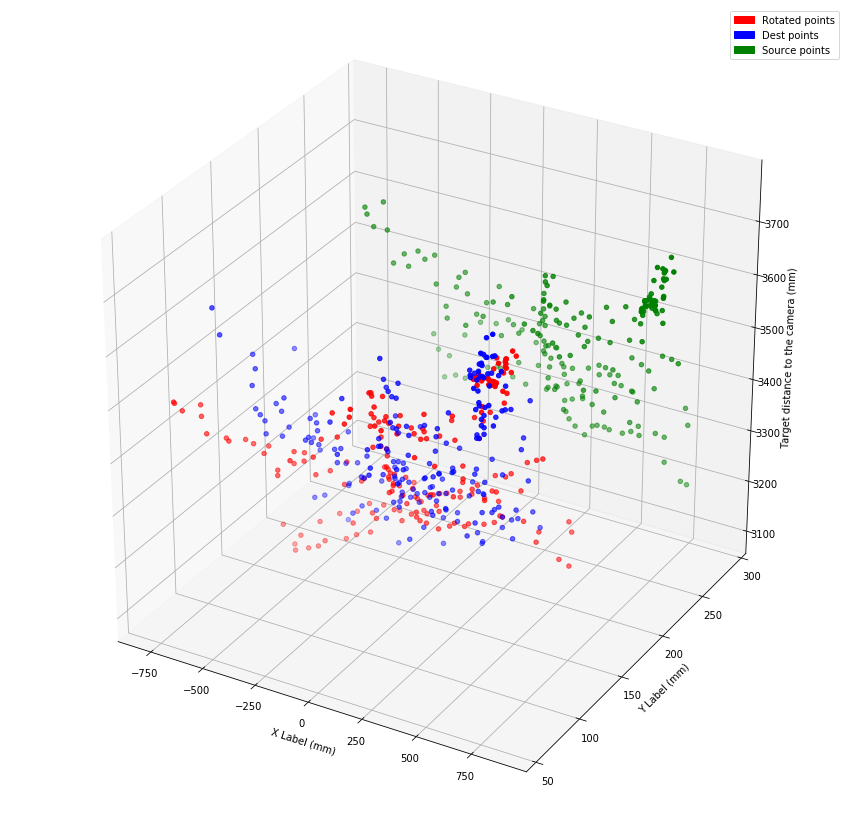

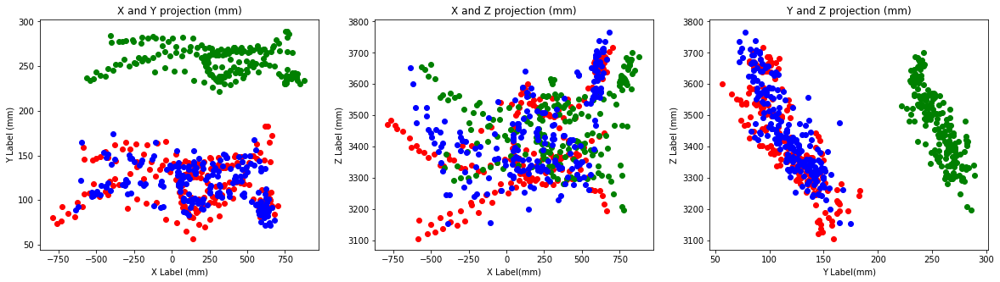

In [20]:
fig2 = plt.figure(figsize=(15,15))
ax2 = fig2.add_subplot(111, projection='3d' )
green_patch = mpatches.Patch(color='green', label='Source points')
red_patch = mpatches.Patch(color='red', label='Rotated points')
blue_patch = mpatches.Patch(color='blue', label='Dest points')
plt.legend(handles=[red_patch,blue_patch,green_patch])
ax2.set_xlabel('X Label (mm)')
ax2.set_ylabel('Y Label (mm)')
ax2.set_zlabel('Target distance to the camera (mm)')



ax2.scatter(new_points[:,0],new_points[:,1],new_points[:,2], c='r')
ax2.scatter(objectPoints1[:,0],objectPoints1[:,1],objectPoints1[:,2], c='g')
ax2.scatter(objectPoints2[:,0],objectPoints2[:,1],objectPoints2[:,2], c='b')




fig_final, axs_f = plt.subplots(1,3,figsize=(20,5))

axs_f[0].scatter(new_points[:,0],new_points[:,1], c='r')
axs_f[0].scatter(objectPoints1[:,0],objectPoints1[:,1], c='g')
axs_f[0].scatter(objectPoints2[:,0],objectPoints2[:,1], c='b')
axs_f[0].set_xlabel('X Label (mm)')
axs_f[0].set_ylabel('Y Label (mm)')
axs_f[0].set_title('X and Y projection (mm)')

axs_f[1].scatter(new_points[:,0],new_points[:,2], c='r')
axs_f[1].scatter(objectPoints1[:,0],objectPoints1[:,2], c='g')
axs_f[1].scatter(objectPoints2[:,0],objectPoints2[:,2], c='b')
axs_f[1].set_xlabel('X Label(mm)')
axs_f[1].set_ylabel('Z Label (mm)')
axs_f[1].set_title('X and Z projection (mm)')

axs_f[2].scatter(new_points[:,1],new_points[:,2], c='r')
axs_f[2].scatter(objectPoints1[:,1],objectPoints1[:,2], c='g')
axs_f[2].scatter(objectPoints2[:,1],objectPoints2[:,2], c='b')
axs_f[2].set_xlabel('Y Label(mm)')
axs_f[2].set_ylabel('Z Label (mm)')
axs_f[2].set_title('Y and Z projection (mm)')

plt.show()